In [11]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import r2_score,mean_squared_error
import matplotlib.pyplot as plt
from pydoc import describe
import pandas as pd
import numpy as np
from sklearn import linear_model
import random

In [12]:
commodity_dict = {
    "arhar": "../static/Arhar.csv",
    "bajra": "../static/Bajra.csv",
    "barley": "../static/Barley.csv",
    "copra": "../static/Copra.csv",
    "cotton": "../static/Cotton.csv",
    "sesamum": "../static/Sesamum.csv",
    "gram": "../static/Gram.csv",
    "groundnut": "../static/Groundnut.csv",
    "jowar": "../static/Jowar.csv",
    "maize": "../static/Maize.csv",
    "masoor": "../static/Masoor.csv",
    "moong": "../static/Moong.csv",
    "niger": "../static/Niger.csv",
    "paddy": "../static/Paddy.csv",
    "ragi": "../static/Ragi.csv",
    "rape": "../static/Rape.csv",
    "jute": "../static/Jute.csv",
    "safflower": "../static/Safflower.csv",
    "soyabean": "../static/Soyabean.csv",
    "sugarcane": "../static/Sugarcane.csv",
    "sunflower": "../static/Sunflower.csv",
    "urad": "../static/Urad.csv",
    "wheat": "../static/Wheat.csv"
}

In [13]:
commodity_lst = []
for commodity in commodity_dict:
    commodity_lst.append(commodity)

#### 1. DecisionTreeRegressor

In [14]:
depth = random.randrange(7, 18)
dt_regressor = DecisionTreeRegressor(max_depth=depth)

C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/4099504818.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-17:] = list(y_pred)
C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/4099504818.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-17:] = list(y_pred)
C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/4099504818.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-

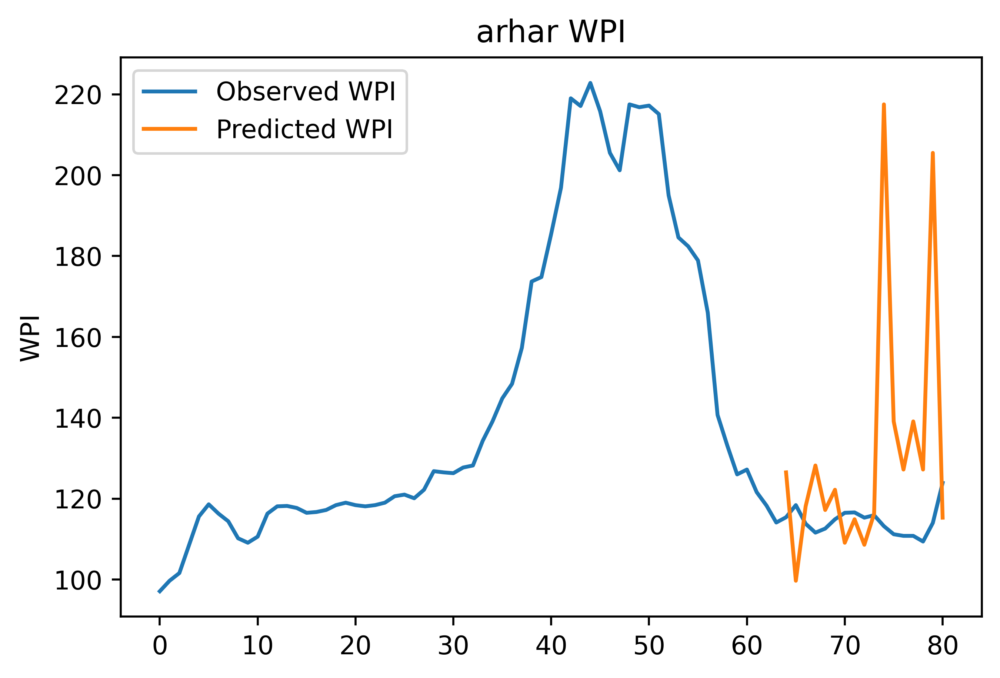

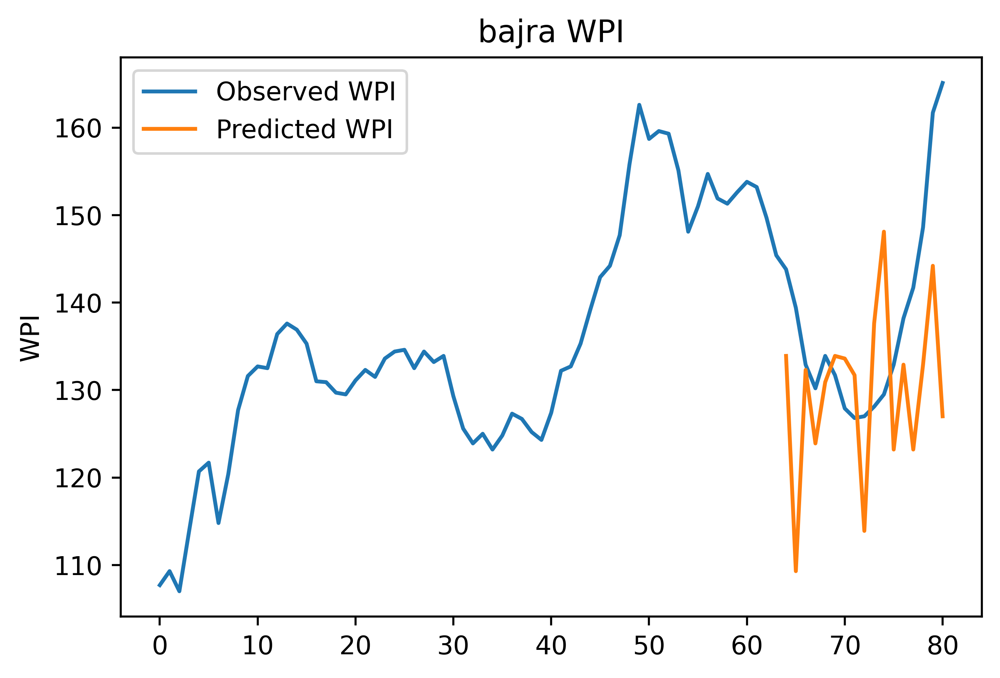

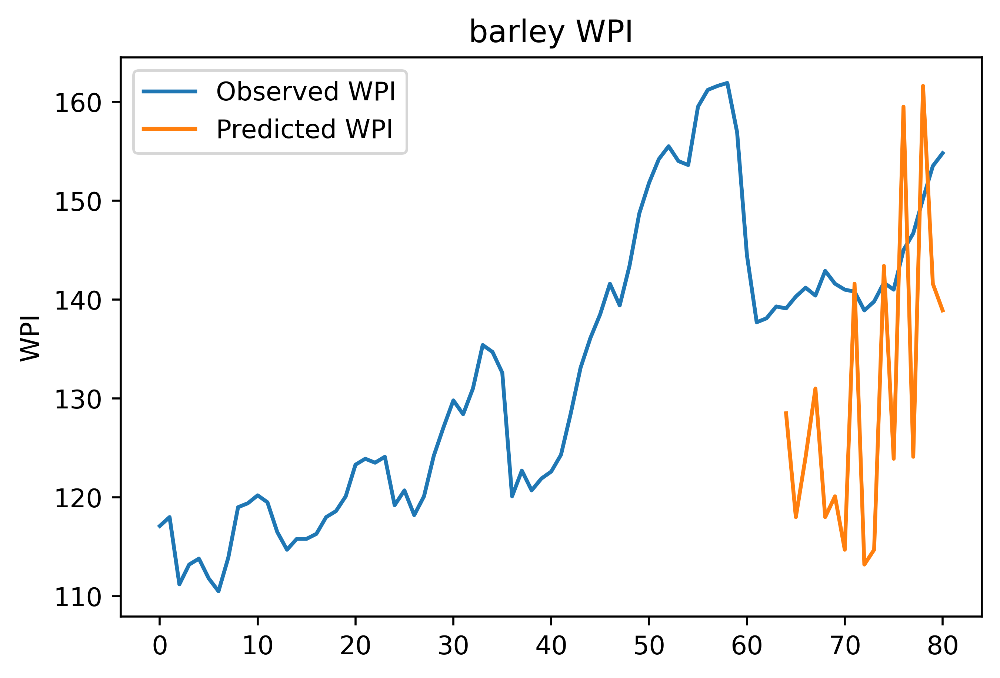

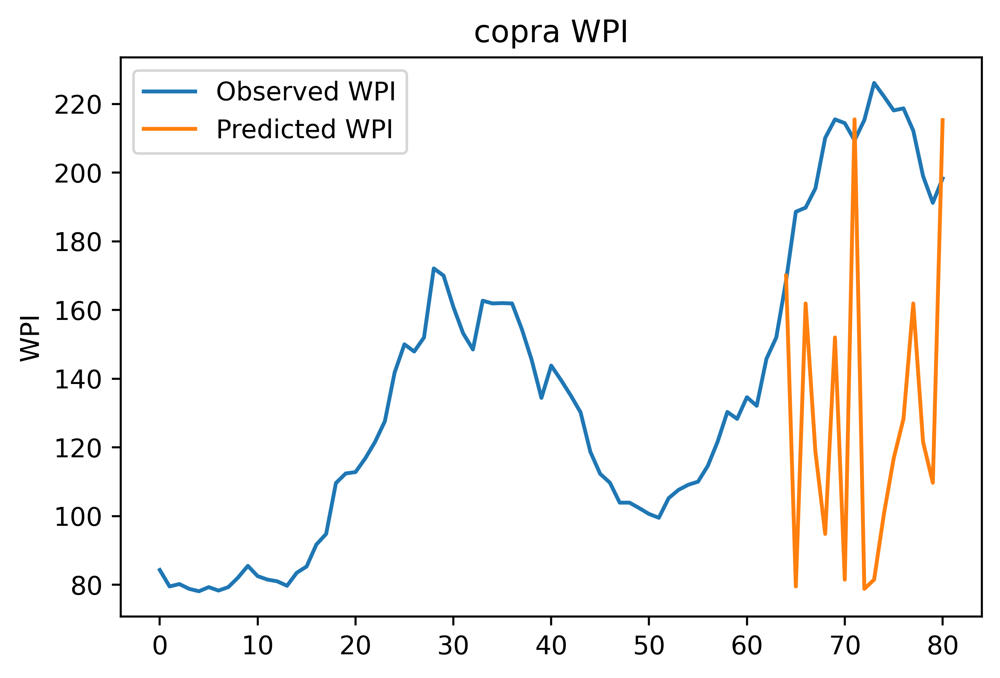

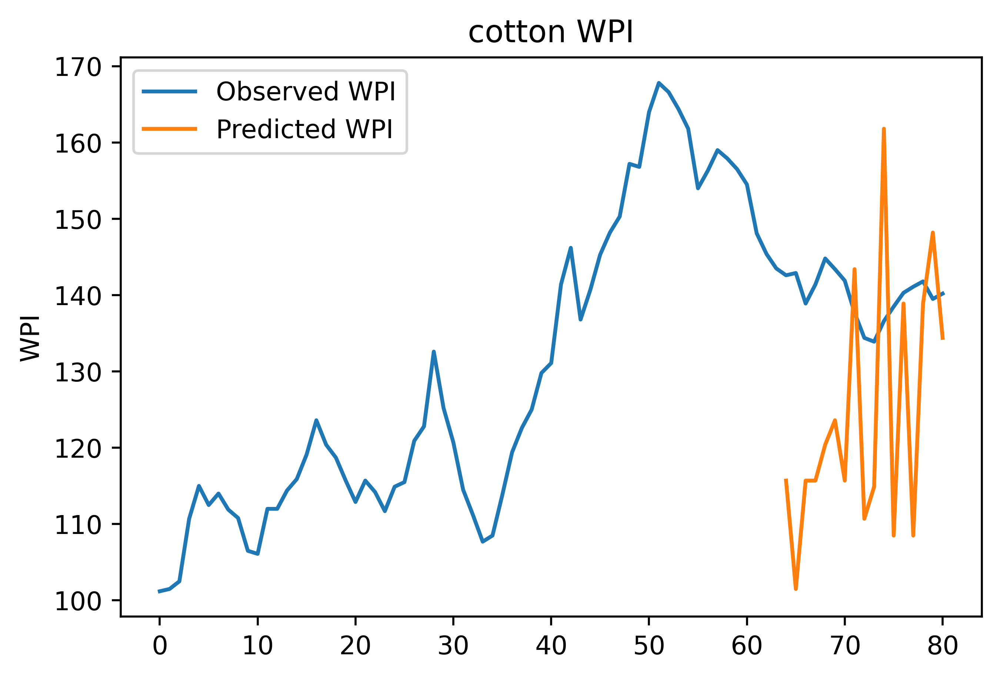

...

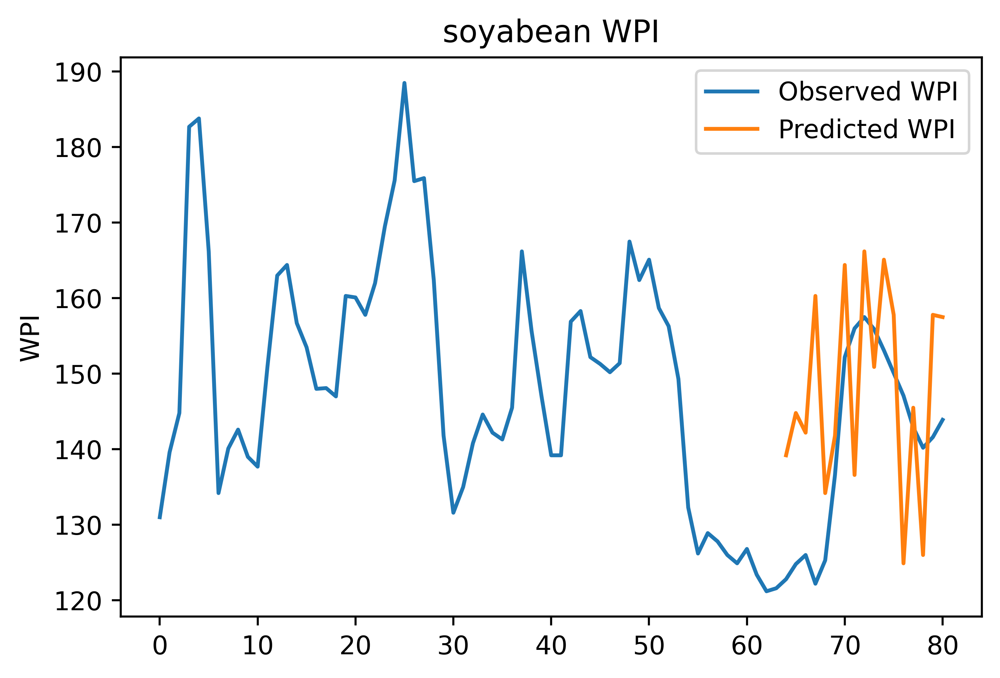

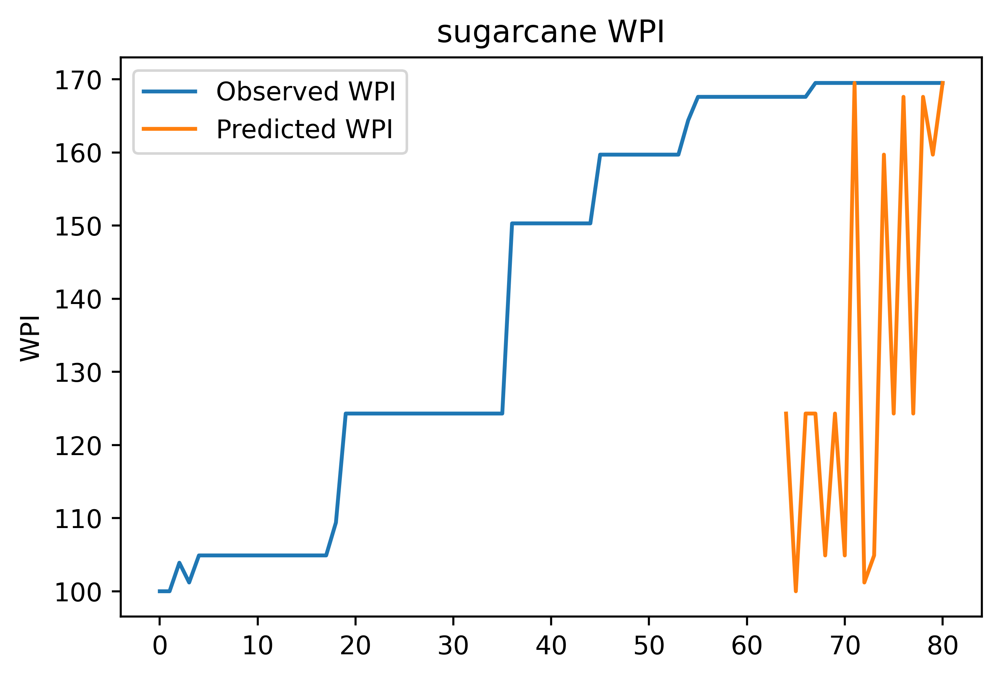

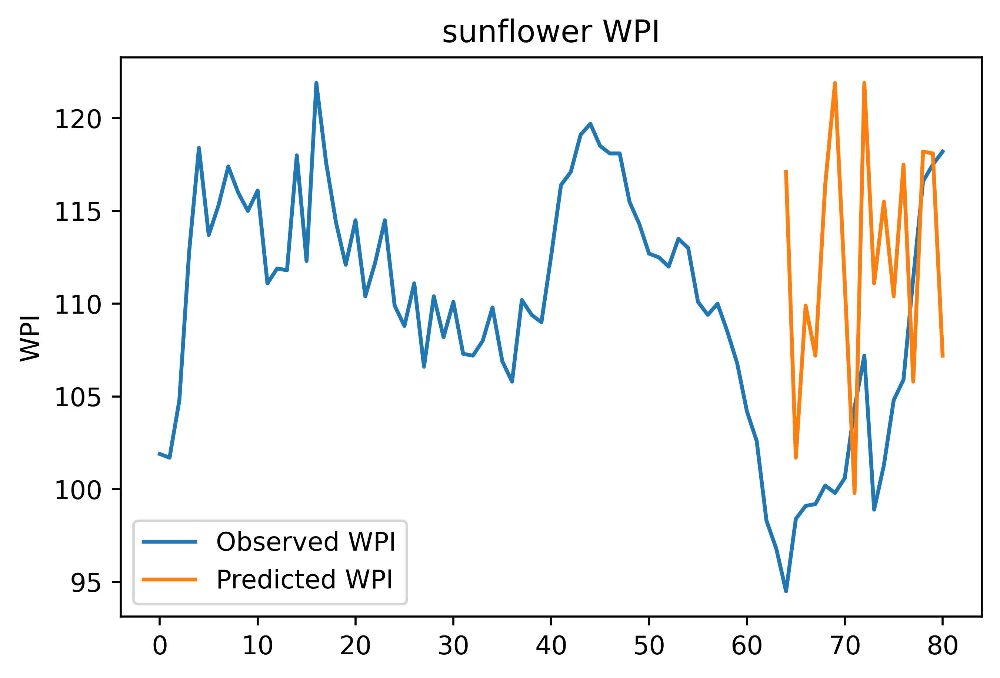

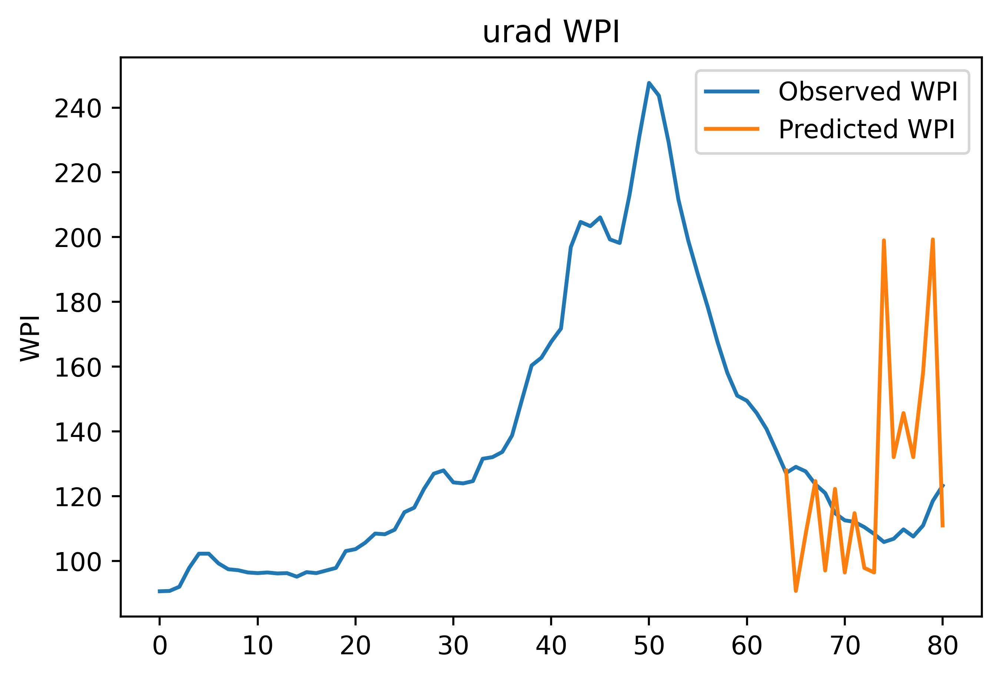

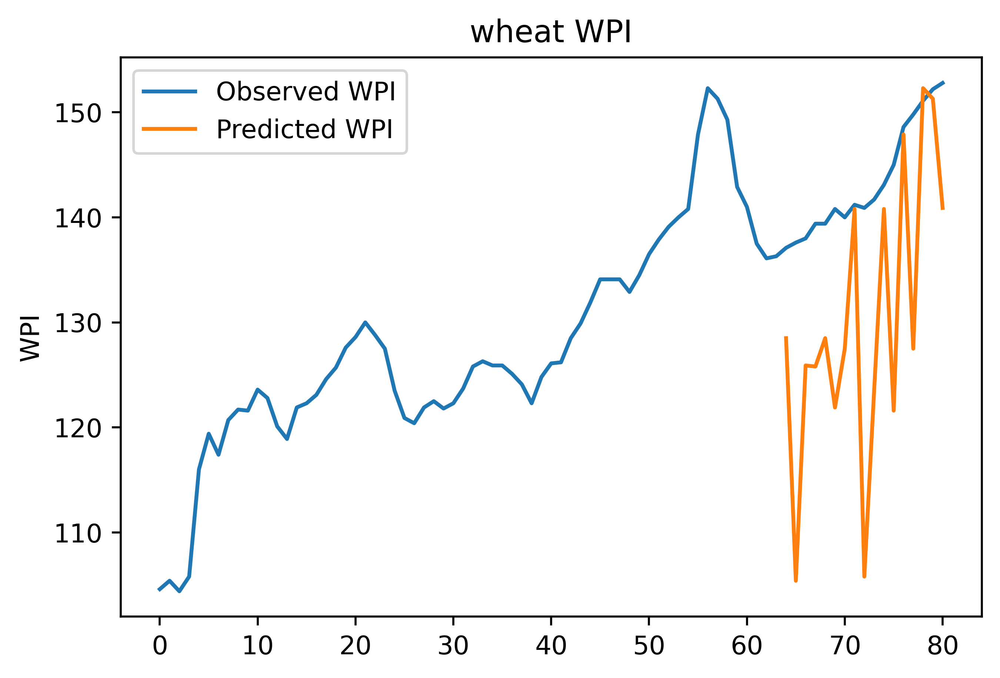

In [15]:
r2_lst = []
mse_lst = []
for commodity in commodity_dict:

#     Model Training and prediction
    df = pd.read_csv(commodity_dict[commodity])
    X = df.iloc[:, :-1].values
    Y = df.iloc[:, 3].values
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
    dt_regressor.fit(X_train, y_train)
    y_pred = dt_regressor.predict(X_test)
    
#     Model Evaluation
    mse = mean_squared_error(y_test, y_pred)
    mse_lst.append(mse)
    r2 = r2_score(y_test, y_pred)
    r2_lst.append(r2)
    
#     Storing Results
    df['WPI_Pred'] = np.nan
    df['WPI_Pred'][-17:] = list(y_pred)
    loc_pred = "../static/predictions/DecisionTreeRegressor/"+commodity+".csv"
    df.to_csv(loc_pred)
    
#     Save Plot as image
    plt.figure(dpi=500)
    plt.plot(df['WPI'],label='Observed WPI')
    plt.plot(df['WPI_Pred'],label='Predicted WPI')
    plot_title = commodity + " WPI"
    plt.title(plot_title)
    plt.ylabel("WPI")
    plt.legend()
    loc_fig = "D:\\Web Projects\\FarmTrade\\CropPredictionServer\\static\\graphs\\DecisionTreeRegressor\\"+commodity+".png"
    plt.savefig(loc_fig)

df_res = pd.DataFrame({"commodity":commodity_lst,"R2-score":r2_lst,"MSE":mse_lst})
df_res.to_csv("../static/Model Eval/DecisionTreeRegressor/model_eval.csv")

#### 2. LassoRegression

In [16]:
lassoReg = linear_model.Lasso(alpha=0.1)

C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/1146629286.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-17:] = list(y_pred)
C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/1146629286.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-17:] = list(y_pred)
C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/1146629286.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-

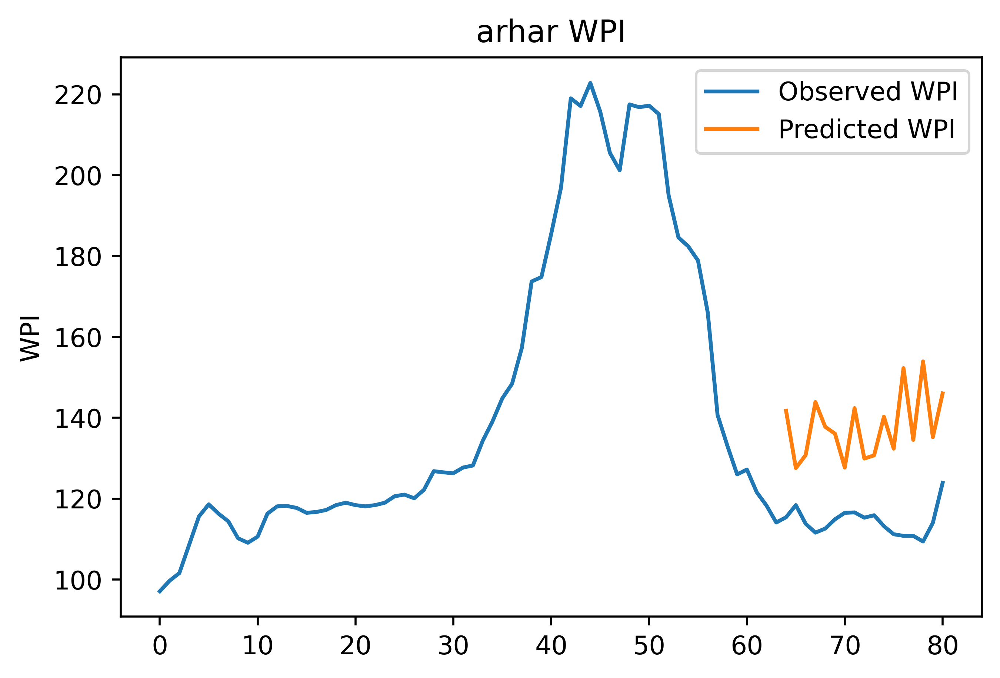

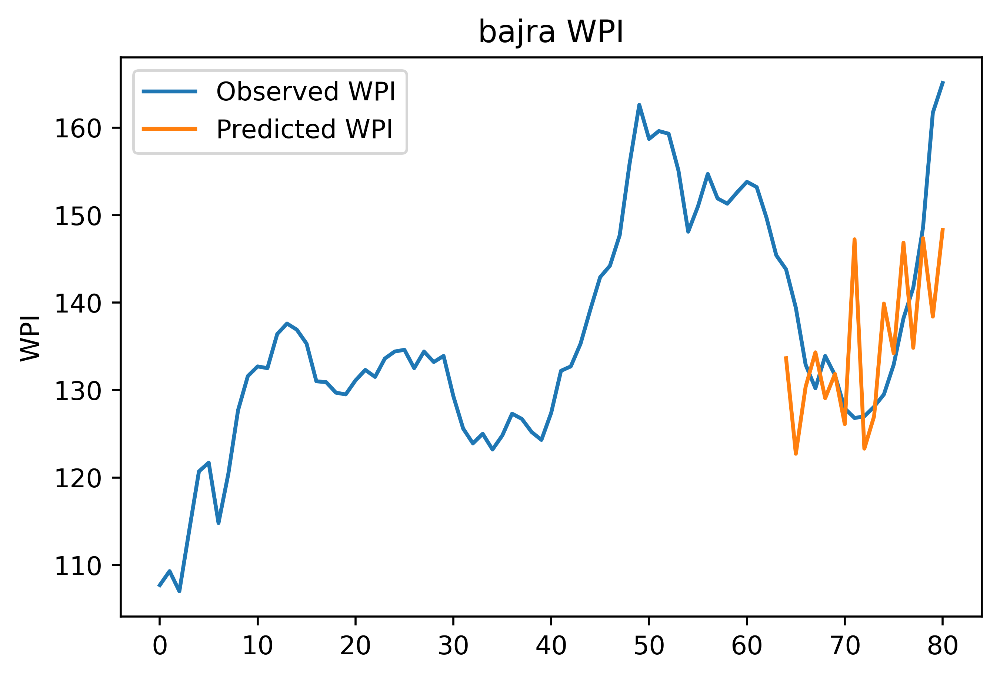

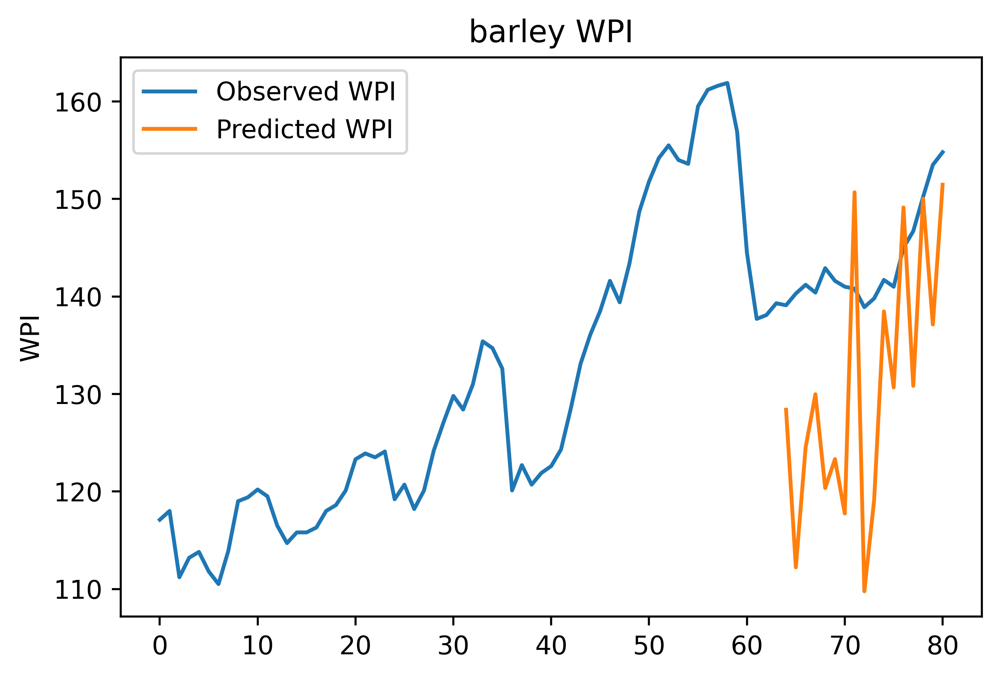

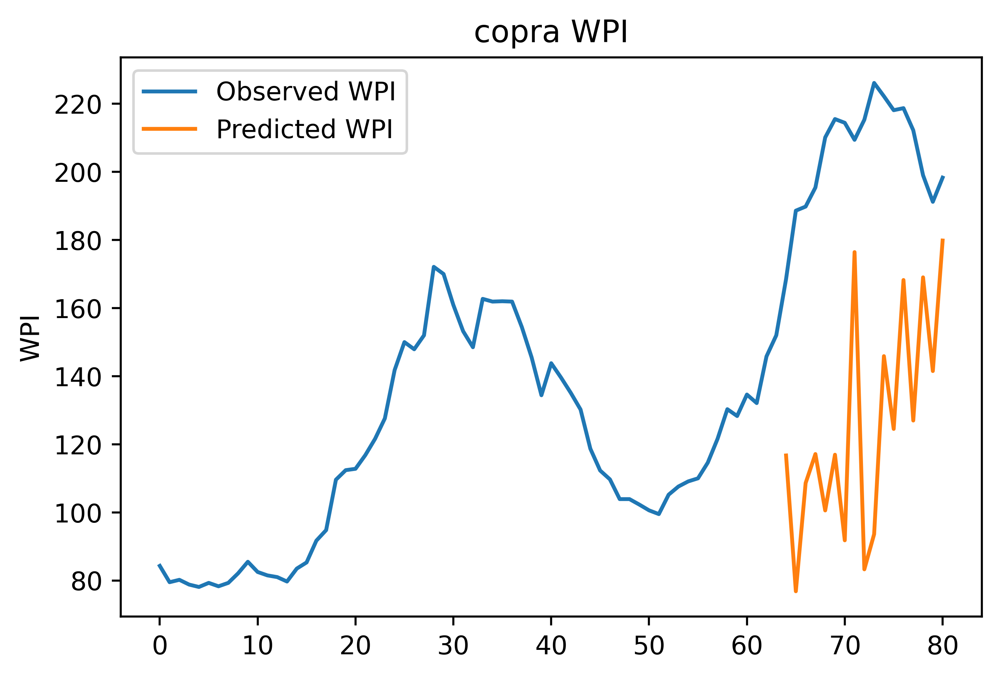

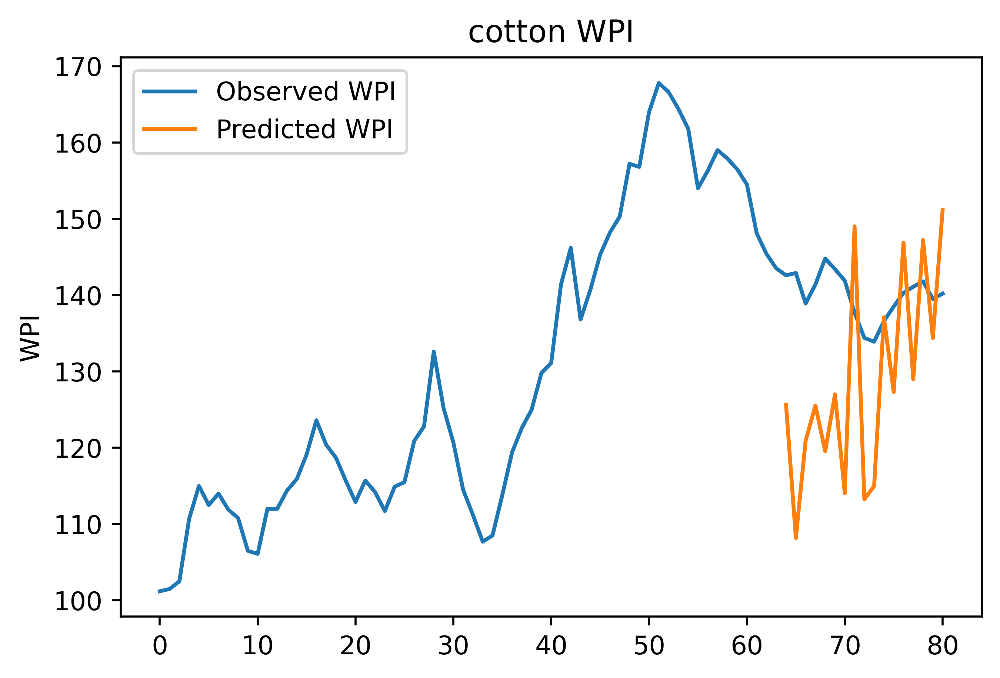

...

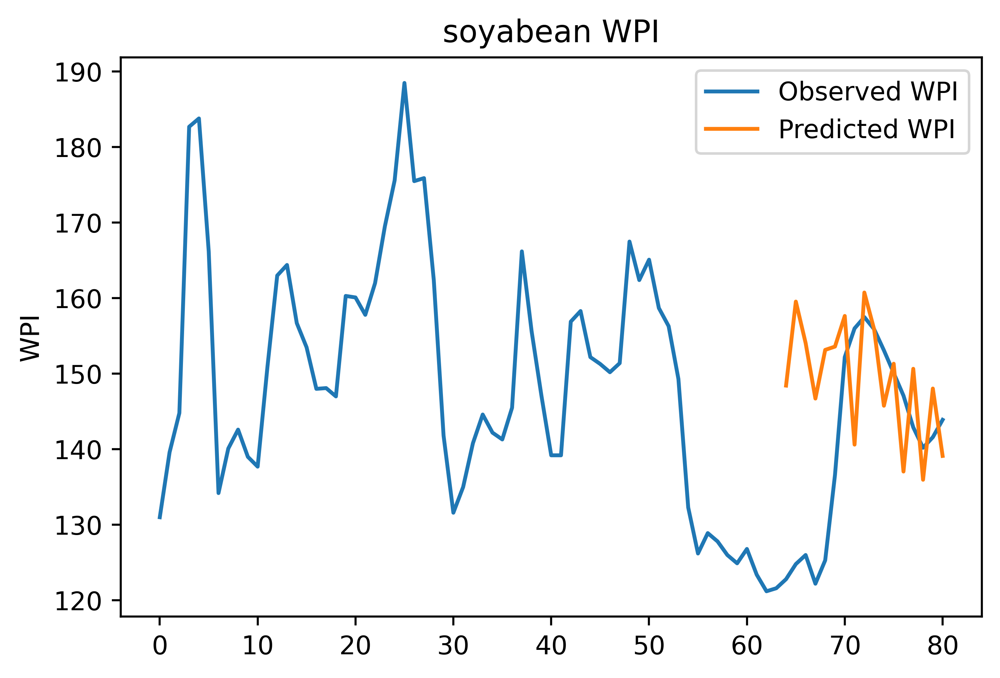

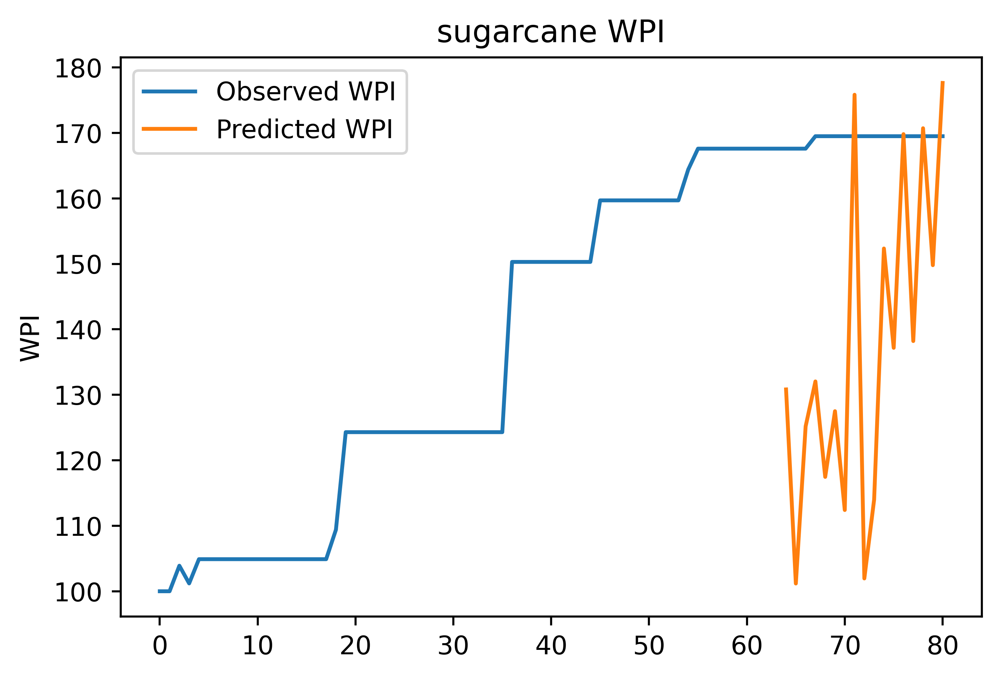

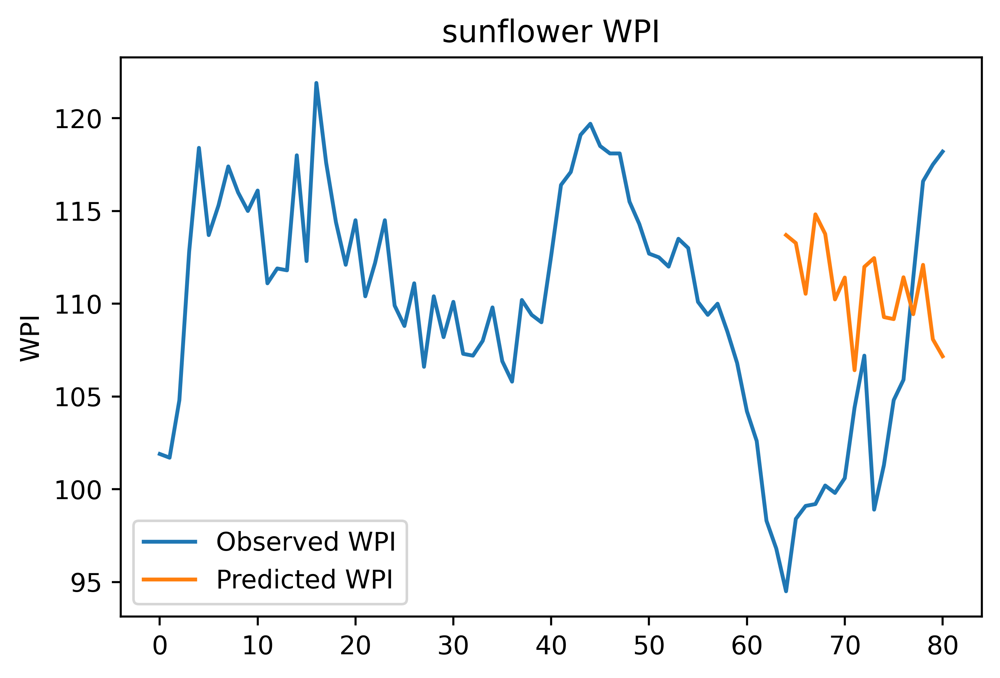

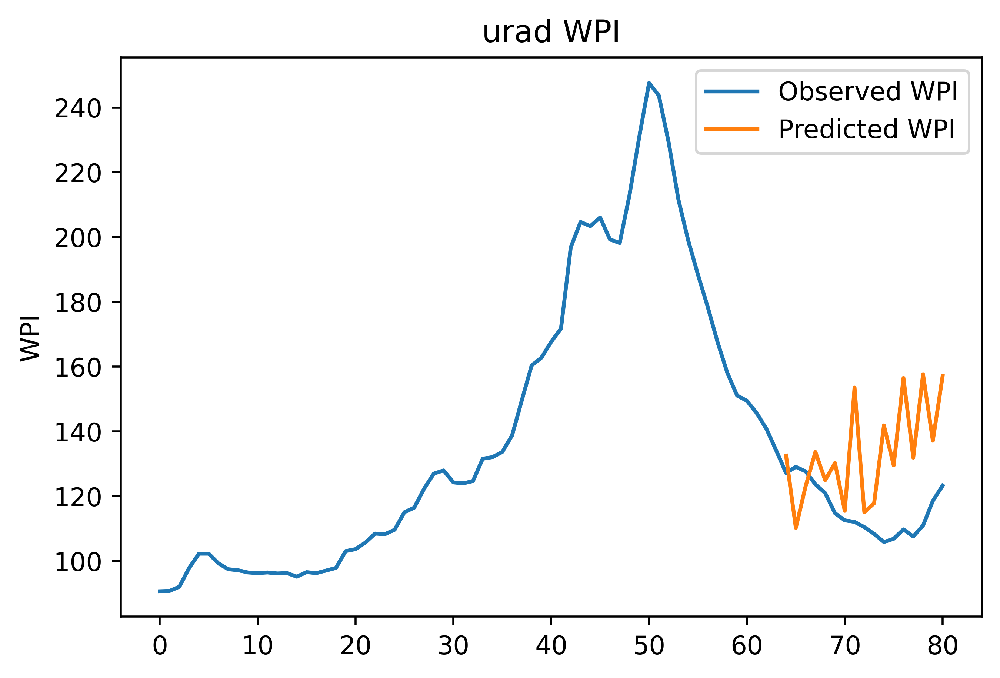

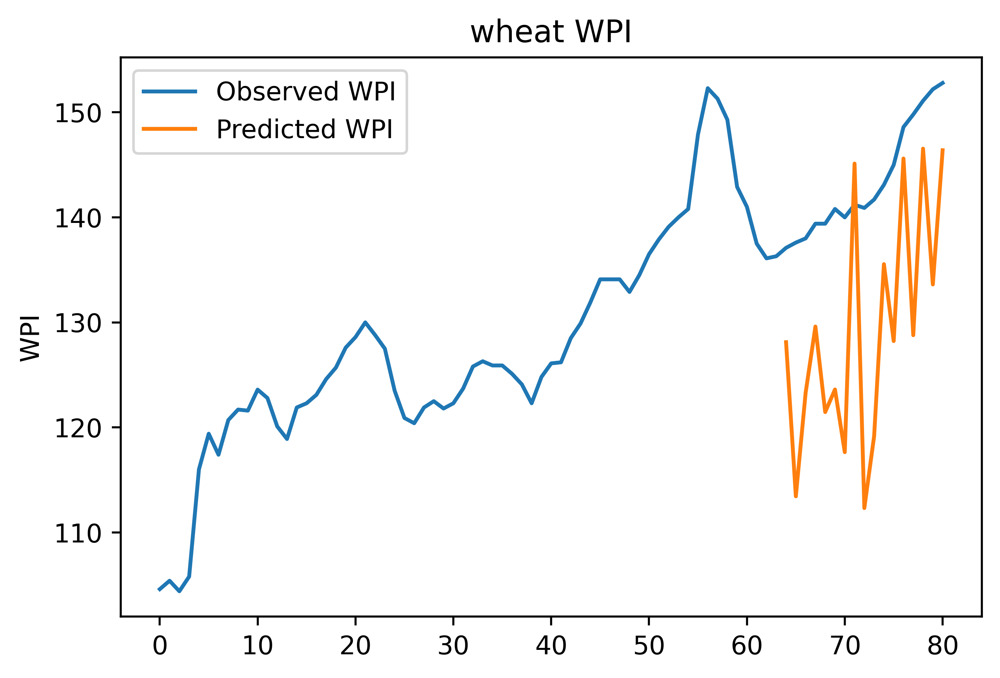

In [17]:
r2_lst = []
mse_lst = []
for commodity in commodity_dict:

#     Model Training and prediction
    df = pd.read_csv(commodity_dict[commodity])
    X = df.iloc[:, :-1].values
    Y = df.iloc[:, 3].values
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
    lassoReg.fit(X_train, y_train)
    y_pred = lassoReg.predict(X_test)
    
#     Model Evaluation
    mse = mean_squared_error(y_test, y_pred)
    mse_lst.append(mse)
    r2 = r2_score(y_test, y_pred)
    r2_lst.append(r2)
    
#     Storing Results
    df['WPI_Pred'] = np.nan
    df['WPI_Pred'][-17:] = list(y_pred)
    loc_pred = "../static/predictions/LassoRegression/"+commodity+".csv"
    df.to_csv(loc_pred)
    
#     Save Plot as image
    plt.figure(dpi=500)
    plt.plot(df['WPI'],label='Observed WPI')
    plt.plot(df['WPI_Pred'],label='Predicted WPI')
    plot_title = commodity + " WPI"
    plt.title(plot_title)
    plt.ylabel("WPI")
    plt.legend()
    loc_fig = "D:\\Web Projects\\FarmTrade\\CropPredictionServer\\static\\graphs\\LassoRegression\\"+commodity+".png"
    plt.savefig(loc_fig)

df_res = pd.DataFrame({"commodity":commodity_lst,"R2-score":r2_lst,"MSE":mse_lst})
df_res.to_csv("../static/Model Eval/LassoRegression/model_eval.csv")

#### 3. LinearRegression

In [18]:
lin_reg = linear_model.LinearRegression()

C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/1344983531.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-17:] = list(y_pred)
C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/1344983531.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-17:] = list(y_pred)
C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/1344983531.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-

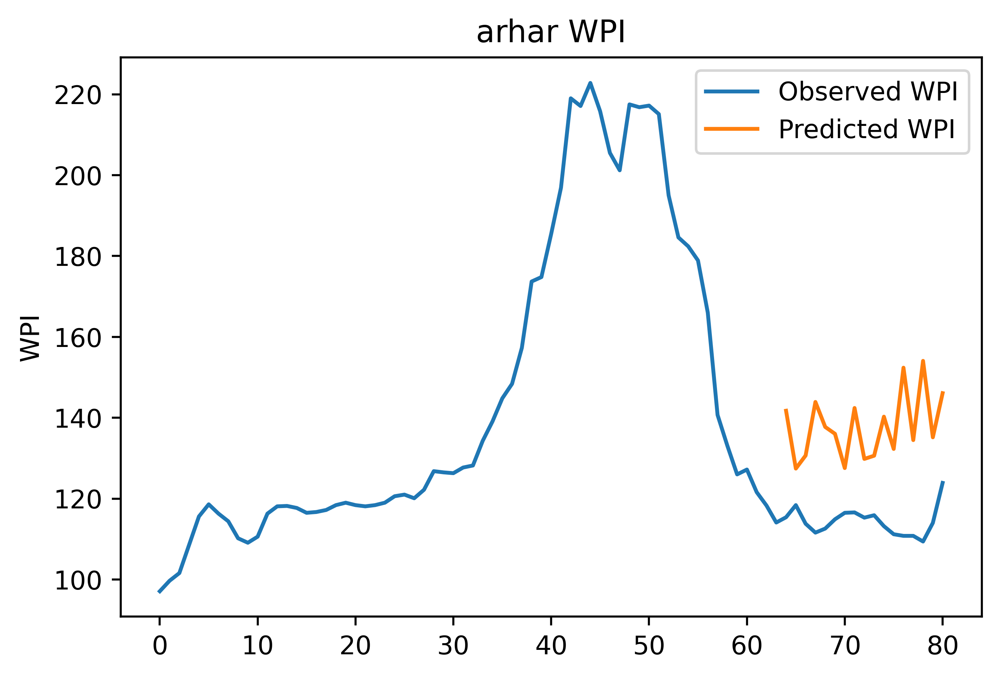

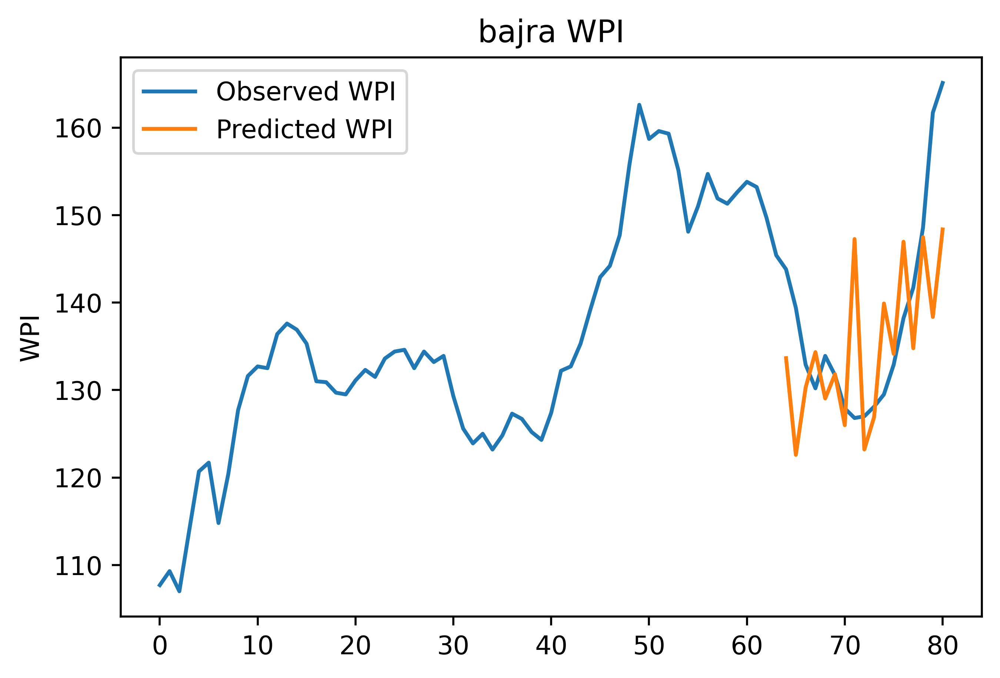

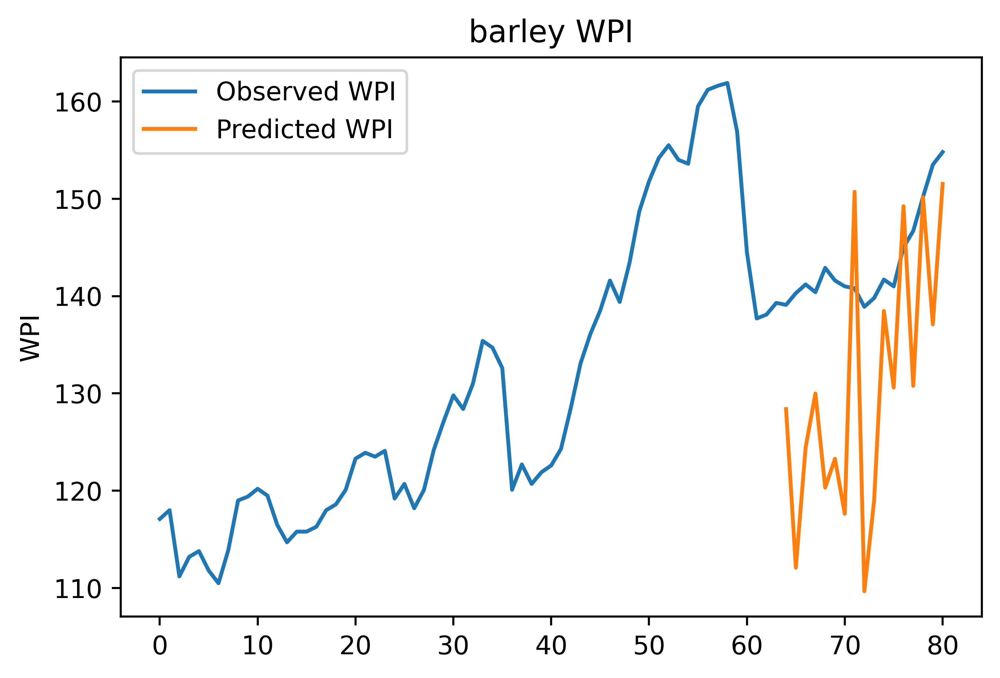

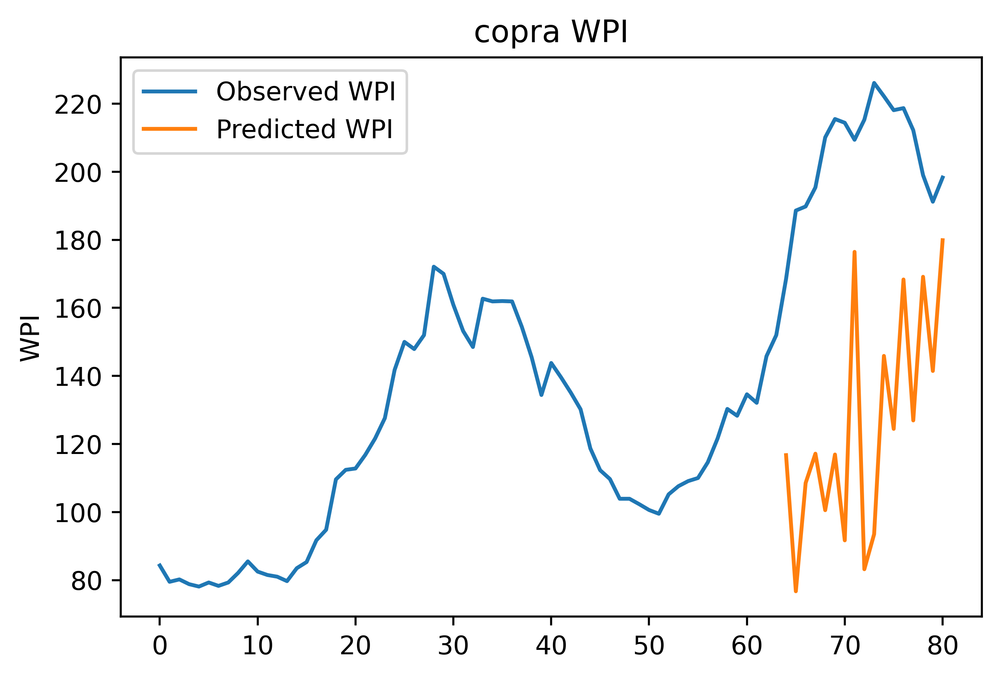

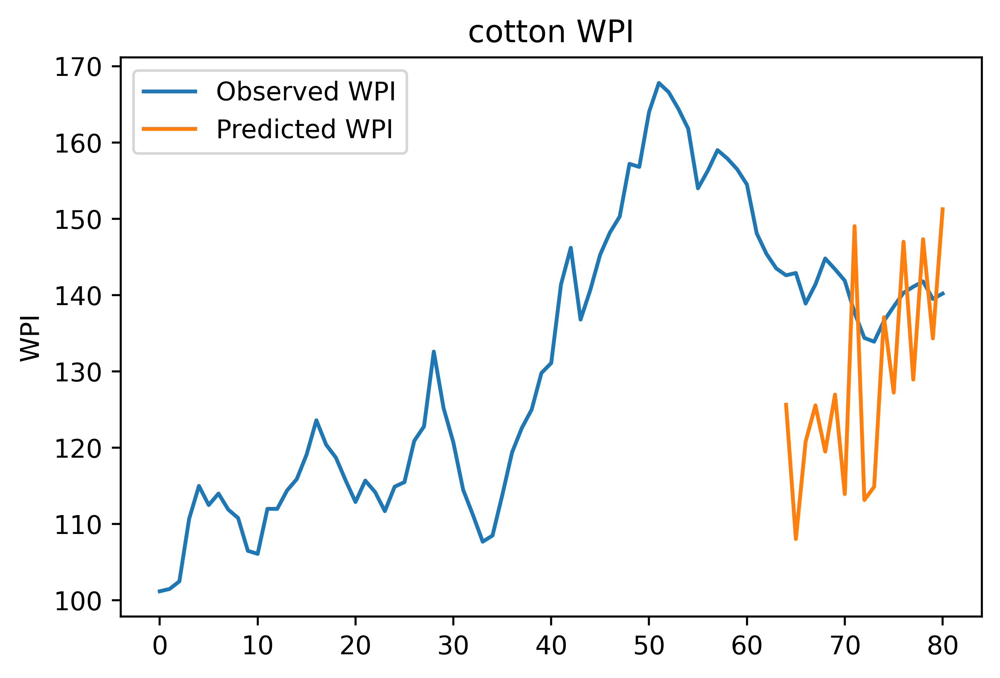

...

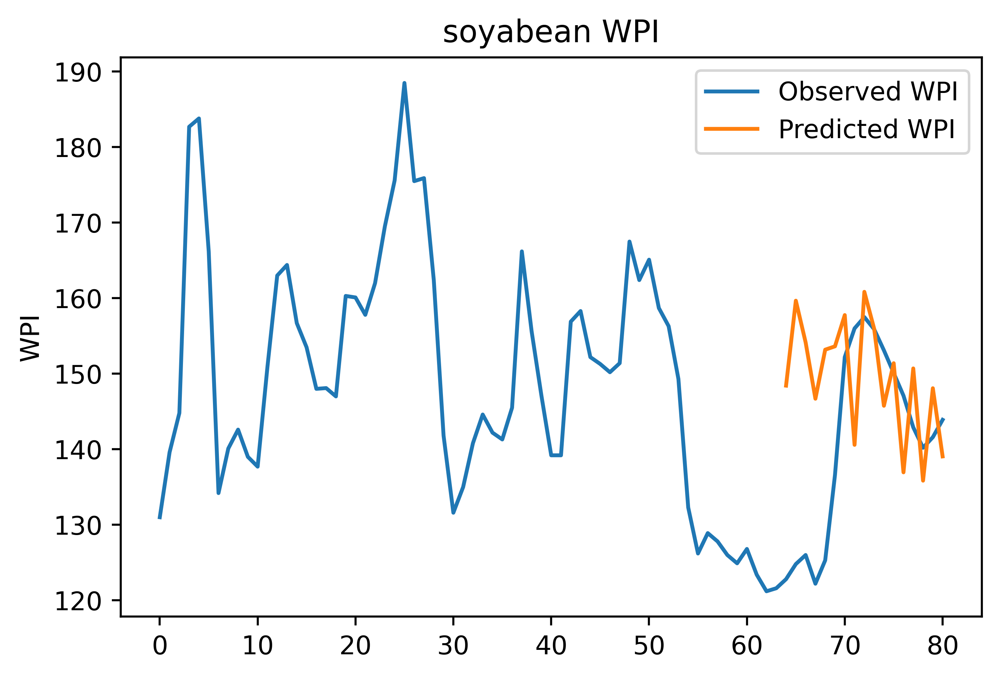

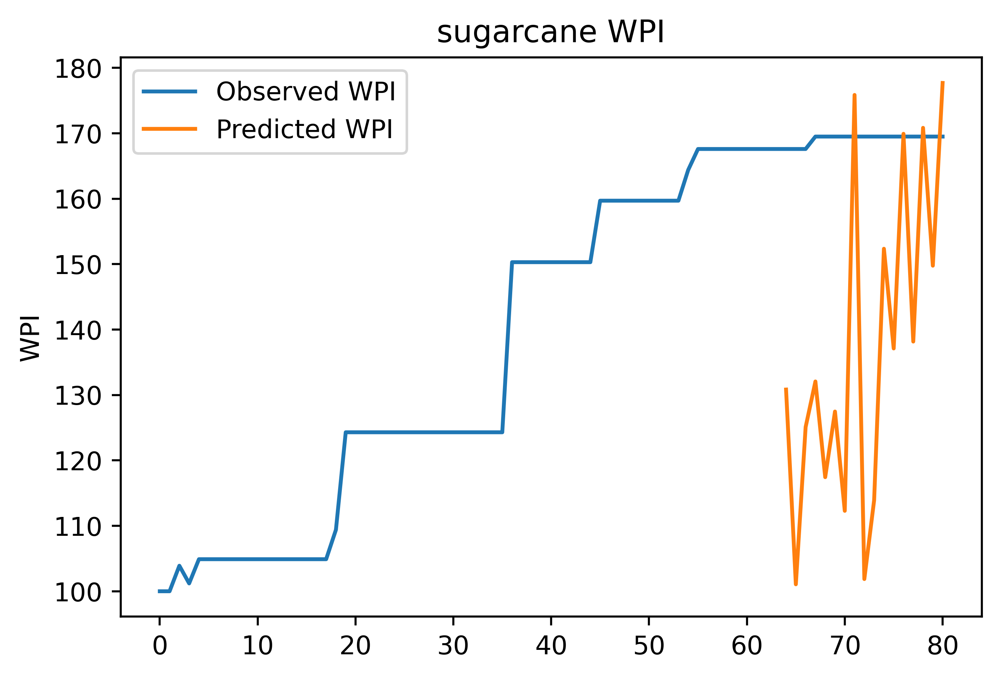

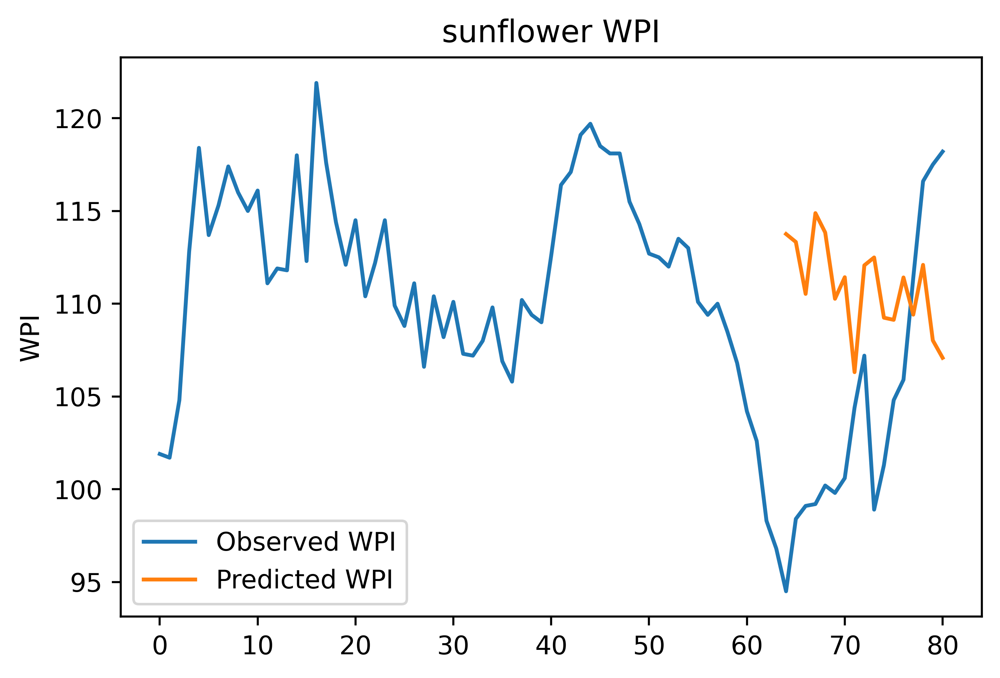

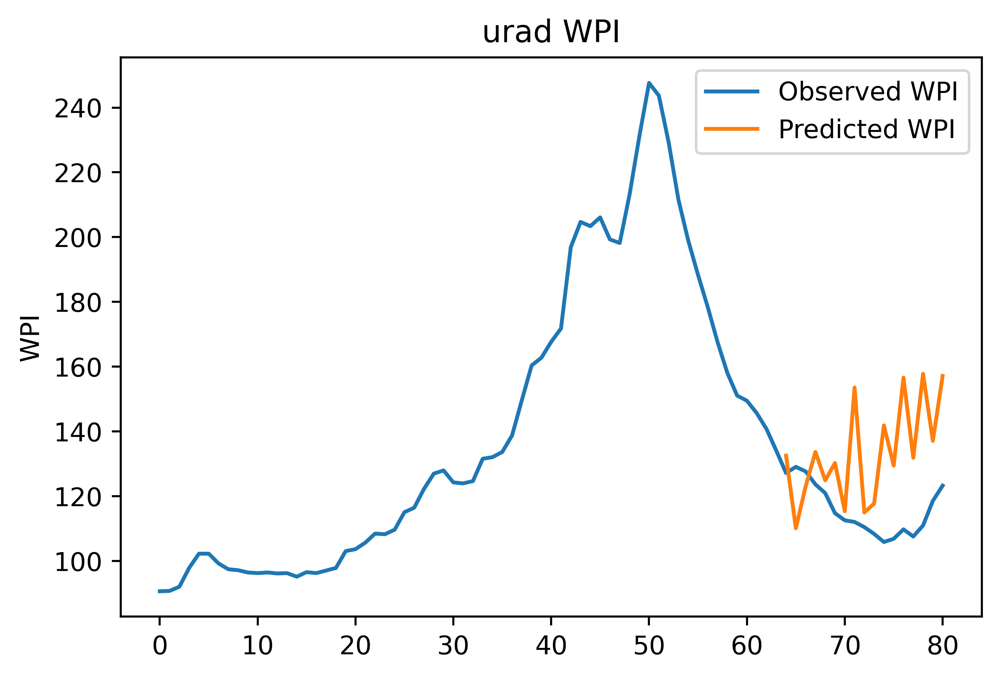

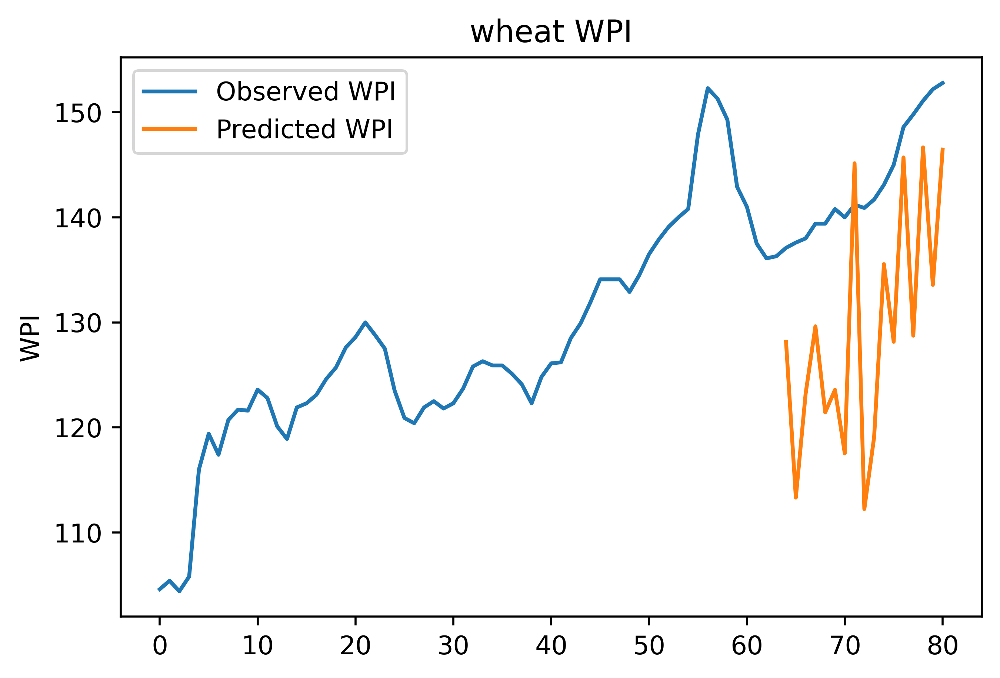

In [19]:
r2_lst = []
mse_lst = []
for commodity in commodity_dict:

#     Model Training and prediction
    df = pd.read_csv(commodity_dict[commodity])
    X = df.iloc[:, :-1].values
    Y = df.iloc[:, 3].values
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
    lin_reg.fit(X_train, y_train)
    y_pred = lin_reg.predict(X_test)
    
#     Model Evaluation
    mse = mean_squared_error(y_test, y_pred)
    mse_lst.append(mse)
    r2 = r2_score(y_test, y_pred)
    r2_lst.append(r2)
    
#     Storing Results
    df['WPI_Pred'] = np.nan
    df['WPI_Pred'][-17:] = list(y_pred)
    loc_pred = "../static/predictions/LinearRegression/"+commodity+".csv"
    df.to_csv(loc_pred)
    
#     Save Plot as image
    plt.figure(dpi=500)
    plt.plot(df['WPI'],label='Observed WPI')
    plt.plot(df['WPI_Pred'],label='Predicted WPI')
    plot_title = commodity + " WPI"
    plt.title(plot_title)
    plt.ylabel("WPI")
    plt.legend()
    loc_fig = "D:\\Web Projects\\FarmTrade\\CropPredictionServer\\static\\graphs\\LinearRegression\\"+commodity+".png"
    plt.savefig(loc_fig)

df_res = pd.DataFrame({"commodity":commodity_lst,"R2-score":r2_lst,"MSE":mse_lst})
df_res.to_csv("../static/Model Eval/LinearRegression/model_eval.csv")

#### 4. RandomForestRegressor

In [20]:
 # create regressor object
rf_regressor = RandomForestRegressor(n_estimators = 100, random_state = 0)

C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/3795243638.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-17:] = list(y_pred)
C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/3795243638.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-17:] = list(y_pred)
C:\Users\Abhishek\AppData\Local\Temp/ipykernel_22812/3795243638.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WPI_Pred'][-

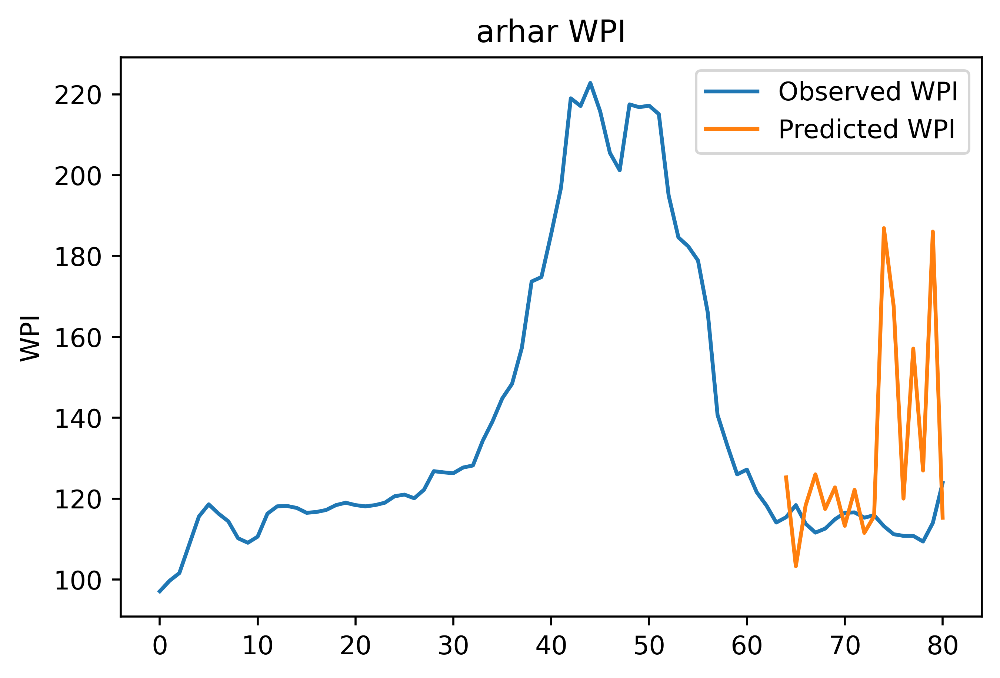

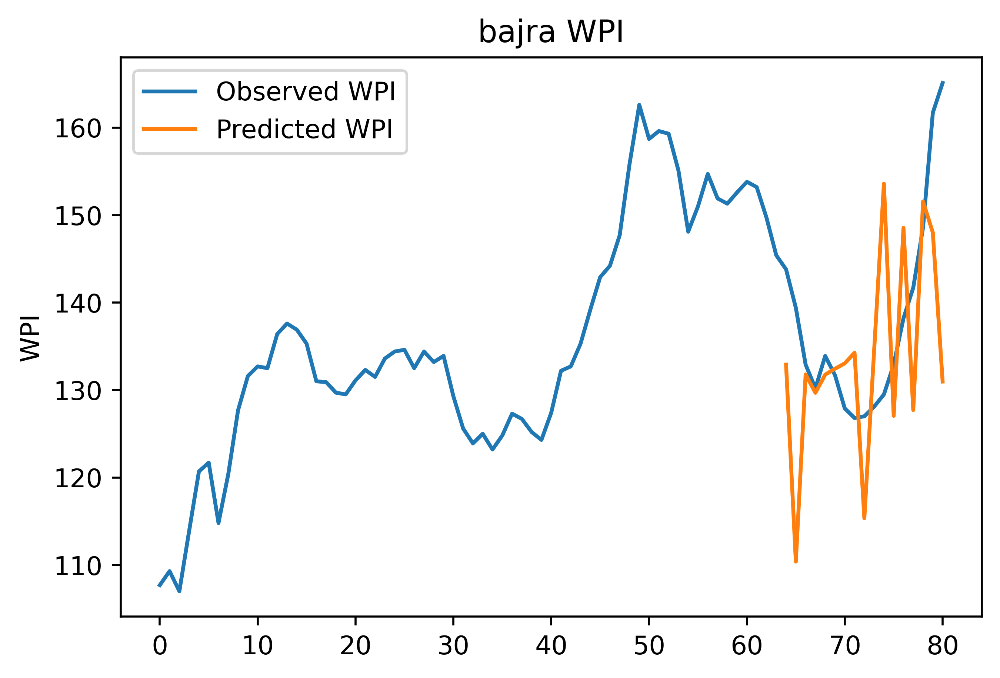

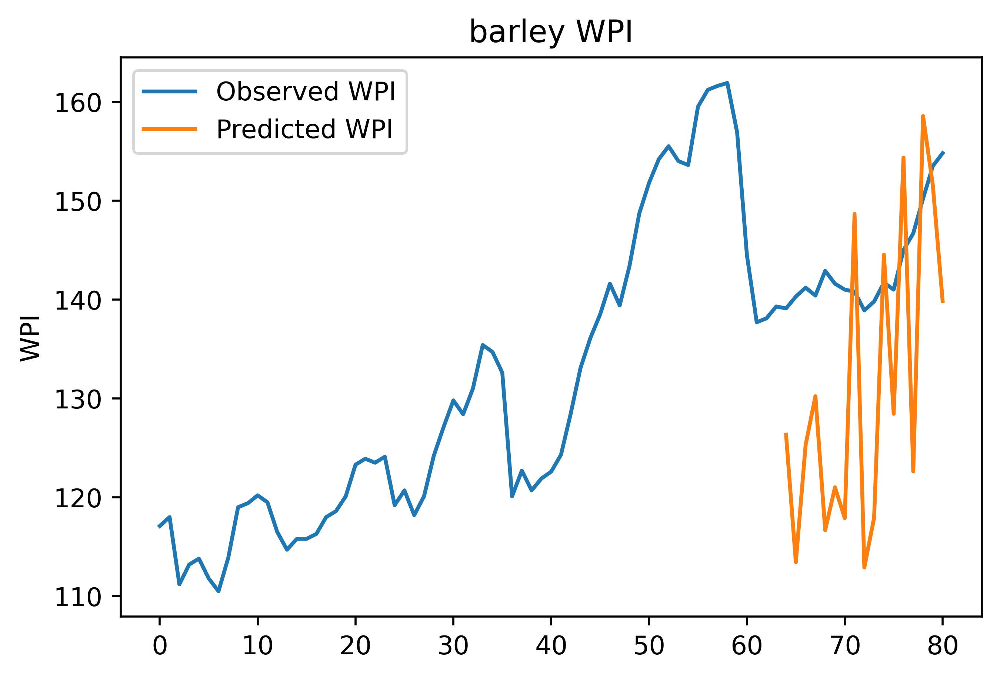

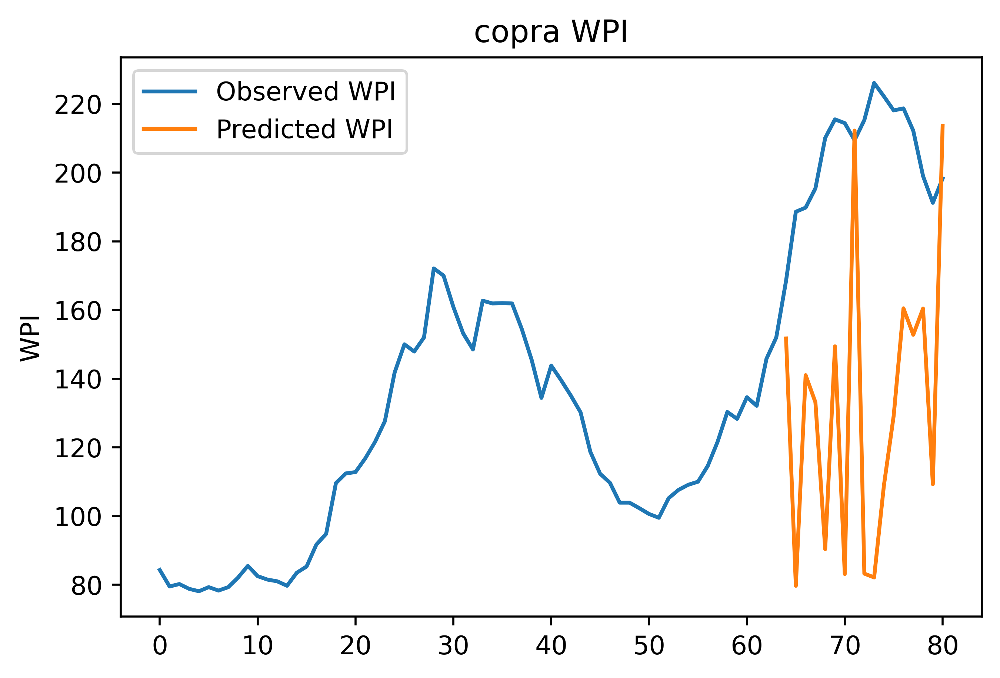

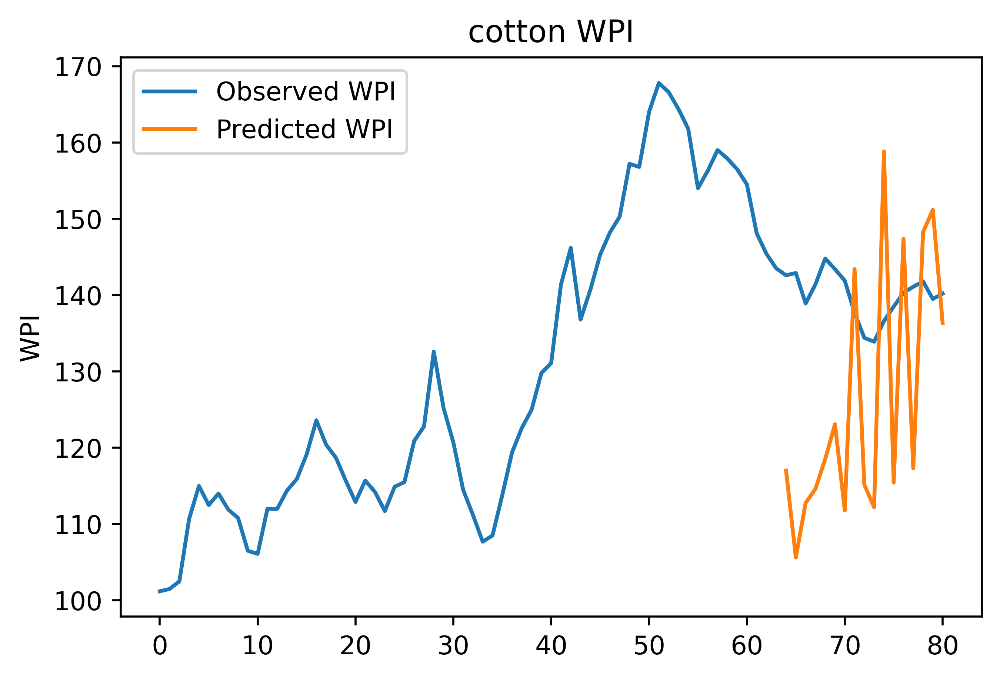

...

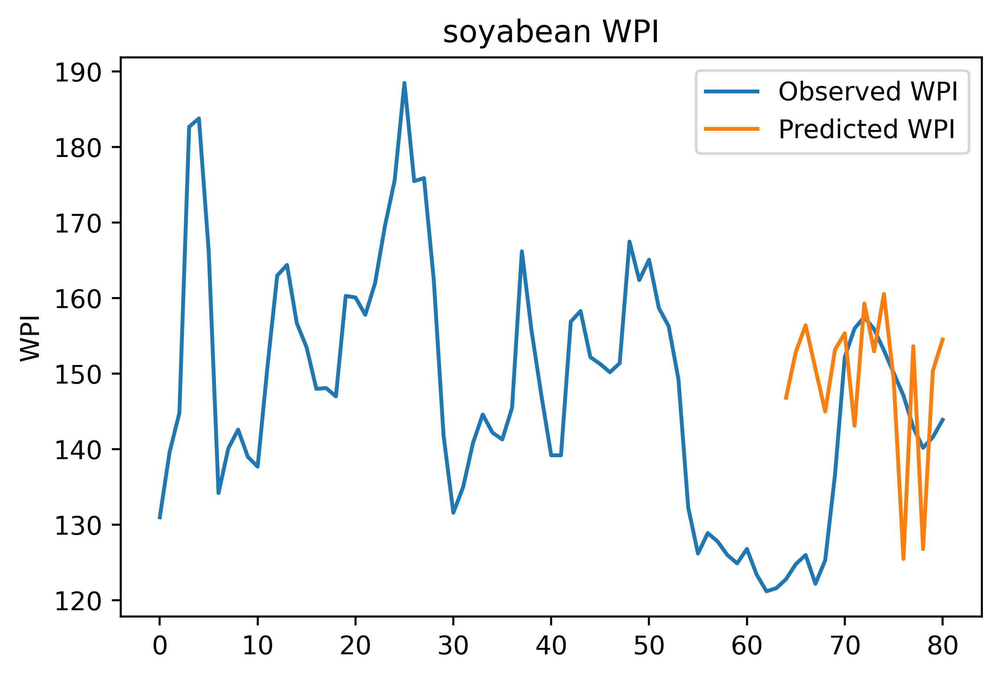

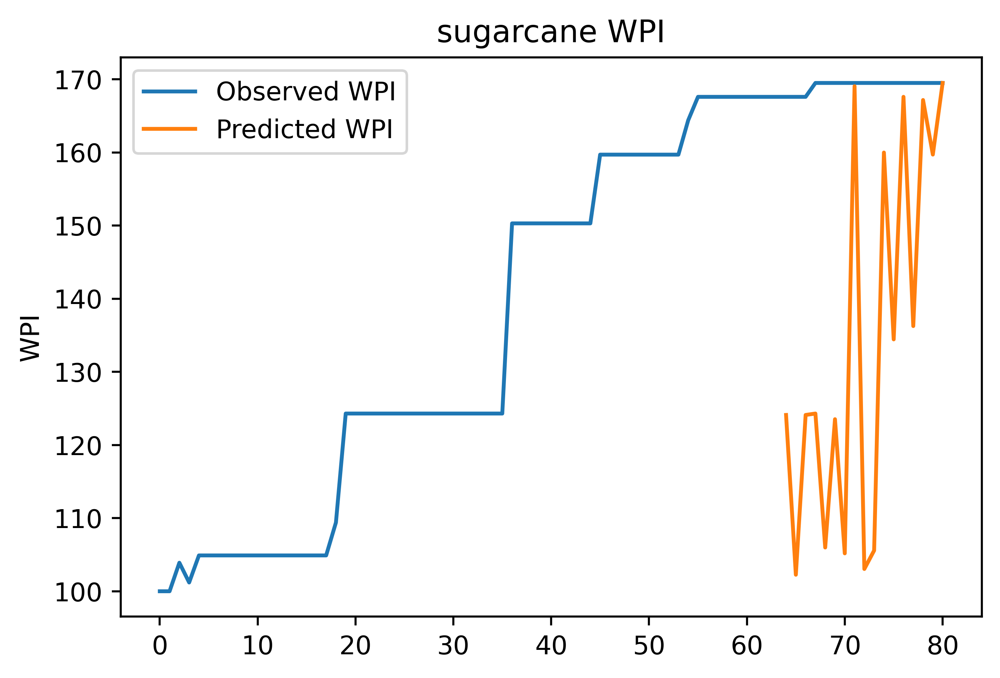

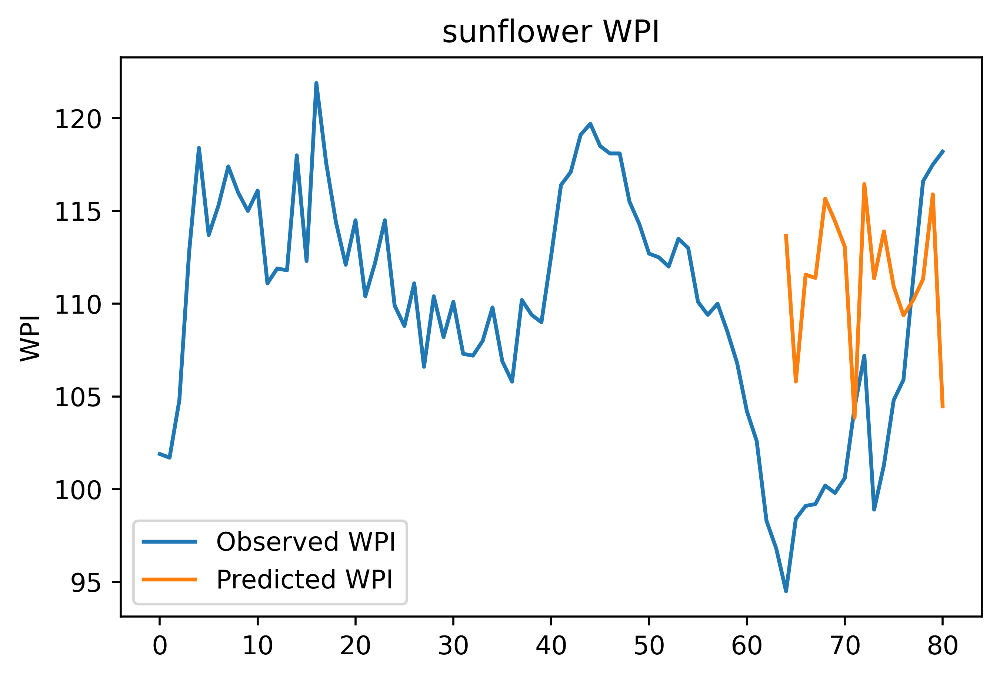

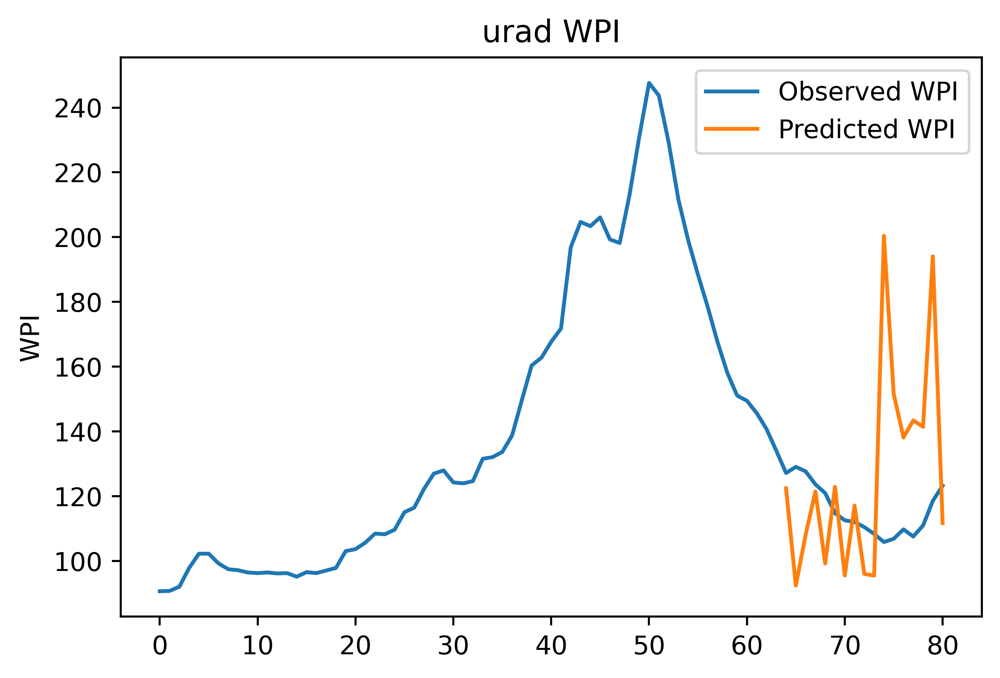

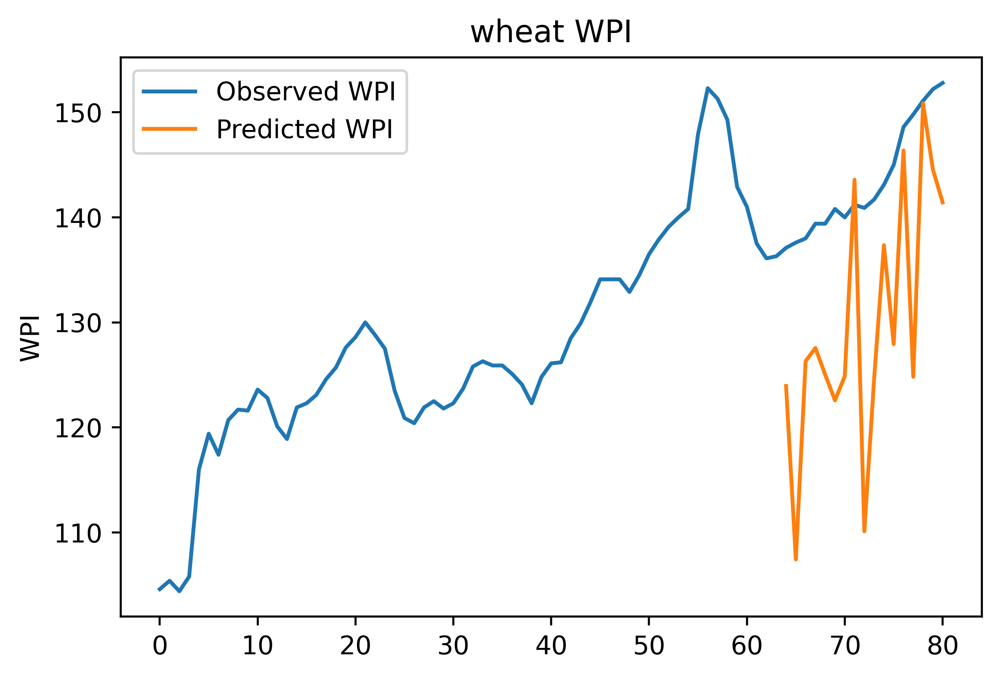

In [21]:
r2_lst = []
mse_lst = []
for commodity in commodity_dict:

#     Model Training and prediction
    df = pd.read_csv(commodity_dict[commodity])
    X = df.iloc[:, :-1].values
    Y = df.iloc[:, 3].values
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
    rf_regressor.fit(X_train, y_train)
    y_pred = rf_regressor.predict(X_test)
    
#     Model Evaluation
    mse = mean_squared_error(y_test, y_pred)
    mse_lst.append(mse)
    r2 = r2_score(y_test, y_pred)
    r2_lst.append(r2)
    
#     Storing Results
    df['WPI_Pred'] = np.nan
    df['WPI_Pred'][-17:] = list(y_pred)
    loc_pred = "../static/predictions/RandomForestRegressor/"+commodity+".csv"
    df.to_csv(loc_pred)
    
#     Save Plot as image
    plt.figure(dpi=500)
    plt.plot(df['WPI'],label='Observed WPI')
    plt.plot(df['WPI_Pred'],label='Predicted WPI')
    plot_title = commodity + " WPI"
    plt.title(plot_title)
    plt.ylabel("WPI")
    plt.legend()
    loc_fig = "D:\\Web Projects\\FarmTrade\\CropPredictionServer\\static\\graphs\\RandomForestRegressor\\"+commodity+".png"
    plt.savefig(loc_fig)

df_res = pd.DataFrame({"commodity":commodity_lst,"R2-score":r2_lst,"MSE":mse_lst})
df_res.to_csv("../static/Model Eval/RandomForestRegressor/model_eval.csv")